In [2]:
# %matplotlib inline
import os
import sys
sys.path.append(os.path.abspath("/ocean/projects/asc170022p/shg121/PhD/Project_Pruning"))
from Saliency_Visualization.Grad_cam_Resnet_50 import GradCamModel
from dataset.dataset_cubs import Dataset_cub
import h5py
import pickle
from sklearn.utils import shuffle
import numpy as np
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from tqdm import tqdm
import time
import pickle

import torch
from torch.utils.data import DataLoader
from torchvision import transforms

import utils
from model_factory.models import Classifier
from model_factory.model_meta import Model_Meta
from dataset.dataset_utils import get_dataset_with_attributes, get_transforms, get_dataset_with_image_and_attributes, get_transform_cub
from dataset.dataset_attributes_mnist import Dataset_attributes_mnist

import matplotlib.pyplot as plt

In [3]:
img_size= 448
seed= 0

# dataset_name: ["mnist", ]
data_root= "/ocean/projects/asc170022p/shg121/PhD/Project_Pruning/data/CUB_200_2011"
json_root= "/ocean/projects/asc170022p/shg121/PhD/Project_Pruning/scripts_data"
dataset_name= "cub"
attribute_file_name="attributes.npy"

# model_arch: ["Resnet_10", "Resnet_18", Resnet_34, "AlexNet"]
model_arch= "Resnet_50"
pretrained= True
transfer_learning= False
batch_size= 32
lr= 0.001
logs= "/ocean/projects/asc170022p/shg121/PhD/Project_Pruning/Results"
bb_layers_for_concepts= [ "layer3" ]
last_model_chk_pt_file= "best_val_prune_iteration_11_model_lt.pth.tar"
last_model_mask_file= "lt_mask_non_zero_params_31.5_ite_11.pkl"
num_classes= 200

# cav_flattening_type: ["max_pooled", "avg_pooled", "flattened"]
cav_flattening_type= "flattened"
#cav_flattening_type: "max_pooled"
#cav_flattening_type: "avg_pooled"


continue_pruning= True
initialized_BB_weights= False
# g model configs:
hidden_features= 500
g_lr= 0.001
th= 0
val_after_th= 0
g_epoch= 50
# for max pooled
# g_chkpt: "best_epoch_16.pth.tar"

# for avg pooled
#g_chkpt: "best_epoch_19.pth.tar"

# for flattened
g_chkpt= "best_epoch_42.pth.tar"


# pruning configs
prune_type= "lt"
prune_iterations= 15
start_iter= 0

prune_percent= 10

# epoch for each of the pruned network
end_iter= 60
resample= False
epsilon= 0.0000006

percent_weight_remaining = [
            100.0, 90.0, 81.0, 72.9, 65.6, 59.1, 53.2, 47.9, 43.1, 38.8, 34.9, 31.5,
            28.3, 25.5, 23.0, 20.7, 18.6, 16.8, 15.1, 13.6, 12.3, 11.0, 9.9, 9.0,
            8.1]

# These concepts are from LENS paper https://arxiv.org/pdf/2106.06804.pdf
#labels_for_tcav: ["Black_footed_Albatross"]
#concepts_for_tcav: ["has_bill_shape_hooked_seabird", "has_bill_length_about_the_same_as_head",
#                    "has_upper_tail_color_grey", "has_belly_color_white",
#                    "has_wing_shape_roundedwings", "has_bill_color_black"]

#labels_for_tcav: [ "Laysan_Albatross" ]
#concepts_for_tcav: [ "has_crown_color_white",
#                     "has_wing_pattern_solid",
#                     "has_under_tail_color_white" ]

#labels_for_tcav: [ "Groove_billed_Ani" ]
#concepts_for_tcav: [ "has_breast_color_black",
#                     "has_leg_color_black",
#                     "has_bill_shape_allpurpose",
#                     "has_bill_length_about_the_same_as_head",
#                     "has_wing_shape_roundedwings" ]

#labels_for_tcav: [ "Crested_Auklet" ]
#concepts_for_tcav: [ "has_nape_color_black",
#                     "has_eye_color_black",
#                     "has_belly_color_white"]

#labels_for_tcav: [ "Least_Auklet" ]
#concepts_for_tcav: [ "has_breast_color_black",
#                     "has_breast_color_white",
#                     "has_nape_color_white",
#                     "has_size_small_5__9_in"]

#labels_for_tcav: [ "Parakeet_Auklet" ]
#concepts_for_tcav: [ "has_size_medium_9__16_in",
#                     "has_primary_color_white",
#                     "has_leg_color_grey" ]

#labels_for_tcav: [ "Rhinoceros_Auklet" ]
#concepts_for_tcav: [ "has_size_medium_9__16_in",
#                     "has_leg_color_buff"]



device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

concept_names= [ 'has_bill_shape_dagger', 'has_bill_shape_hooked_seabird',
                 'has_bill_shape_allpurpose', 'has_bill_shape_cone', 'has_wing_color_brown',
                 'has_wing_color_grey', 'has_wing_color_yellow', 'has_wing_color_black',
                 'has_wing_color_white', 'has_wing_color_buff', 'has_upperparts_color_brown',
                 'has_upperparts_color_grey', 'has_upperparts_color_yellow',
                 'has_upperparts_color_black', 'has_upperparts_color_white',
                 'has_upperparts_color_buff', 'has_underparts_color_brown',
                 'has_underparts_color_grey', 'has_underparts_color_yellow',
                 'has_underparts_color_black', 'has_underparts_color_white',
                 'has_underparts_color_buff', 'has_breast_pattern_solid',
                 'has_breast_pattern_striped', 'has_breast_pattern_multicolored',
                 'has_back_color_brown', 'has_back_color_grey' ,'has_back_color_yellow',
                 'has_back_color_black' ,'has_back_color_white', 'has_back_color_buff',
                 'has_tail_shape_notched_tail', 'has_upper_tail_color_brown',
                 'has_upper_tail_color_grey', 'has_upper_tail_color_black',
                 'has_upper_tail_color_white', 'has_upper_tail_color_buff',
                 'has_head_pattern_plain', 'has_head_pattern_capped',
                 'has_breast_color_brown', 'has_breast_color_grey',
                 'has_breast_color_yellow', 'has_breast_color_black',
                 'has_breast_color_white', 'has_breast_color_buff', 'has_throat_color_grey',
                 'has_throat_color_yellow', 'has_throat_color_black',
                 'has_throat_color_white', 'has_eye_color_black',
                 'has_bill_length_about_the_same_as_head',
                 'has_bill_length_shorter_than_head', 'has_forehead_color_blue',
                 'has_forehead_color_brown', 'has_forehead_color_grey',
                 'has_forehead_color_yellow', 'has_forehead_color_black',
                 'has_forehead_color_white', 'has_forehead_color_red',
                 'has_under_tail_color_brown', 'has_under_tail_color_grey',
                 'has_under_tail_color_yellow', 'has_under_tail_color_black',
                 'has_under_tail_color_white', 'has_under_tail_color_buff',
                 'has_nape_color_blue', 'has_nape_color_brown', 'has_nape_color_grey',
                 'has_nape_color_yellow', 'has_nape_color_black', 'has_nape_color_white',
                 'has_nape_color_buff', 'has_belly_color_grey', 'has_belly_color_yellow',
                 'has_belly_color_black', 'has_belly_color_white', 'has_belly_color_buff',
                 'has_wing_shape_roundedwings', 'has_size_small_5__9_in',
                 'has_size_medium_9__16_in', 'has_size_very_small_3__5_in',
                 'has_shape_perchinglike', 'has_back_pattern_solid',
                 'has_back_pattern_striped', 'has_back_pattern_multicolored',
                 'has_tail_pattern_solid', 'has_tail_pattern_multicolored',
                 'has_belly_pattern_solid', 'has_primary_color_brown',
                 'has_primary_color_grey', 'has_primary_color_yellow',
                 'has_primary_color_black', 'has_primary_color_white',
                 'has_primary_color_buff', 'has_leg_color_grey', 'has_leg_color_black',
                 'has_leg_color_buff', 'has_bill_color_grey', 'has_bill_color_black',
                 'has_crown_color_blue', 'has_crown_color_brown', 'has_crown_color_grey',
                 'has_crown_color_yellow', 'has_crown_color_black', 'has_crown_color_white',
                 'has_wing_pattern_solid', 'has_wing_pattern_striped',
                 'has_wing_pattern_multicolored' ]


labels= [ 'Black_footed_Albatross', 'Laysan_Albatross', 'Sooty_Albatross', 'Groove_billed_Ani', 'Crested_Auklet',
          'Least_Auklet', 'Parakeet_Auklet', 'Rhinoceros_Auklet', 'Brewer_Blackbird', 'Red_winged_Blackbird',
          'Rusty_Blackbird', 'Yellow_headed_Blackbird', 'Bobolink', 'Indigo_Bunting', 'Lazuli_Bunting',
          'Painted_Bunting', 'Cardinal', 'Spotted_Catbird', 'Gray_Catbird', 'Yellow_breasted_Chat', 'Eastern_Towhee',
          'Chuck_will_Widow', 'Brandt_Cormorant', 'Red_faced_Cormorant', 'Pelagic_Cormorant', 'Bronzed_Cowbird',
          'Shiny_Cowbird', 'Brown_Creeper', 'American_Crow', 'Fish_Crow', 'Black_billed_Cuckoo', 'Mangrove_Cuckoo',
          'Yellow_billed_Cuckoo', 'Gray_crowned_Rosy_Finch', 'Purple_Finch', 'Northern_Flicker', 'Acadian_Flycatcher',
          'Great_Crested_Flycatcher', 'Least_Flycatcher', 'Olive_sided_Flycatcher', 'Scissor_tailed_Flycatcher',
          'Vermilion_Flycatcher', 'Yellow_bellied_Flycatcher', 'Frigatebird', 'Northern_Fulmar', 'Gadwall',
          'American_Goldfinch', 'European_Goldfinch', 'Boat_tailed_Grackle', 'Eared_Grebe', 'Horned_Grebe',
          'Pied_billed_Grebe', 'Western_Grebe', 'Blue_Grosbeak', 'Evening_Grosbeak', 'Pine_Grosbeak',
          'Rose_breasted_Grosbeak', 'Pigeon_Guillemot', 'California_Gull', 'Glaucous_winged_Gull', 'Heermann_Gull',
          'Herring_Gull', 'Ivory_Gull', 'Ring_billed_Gull', 'Slaty_backed_Gull', 'Western_Gull', 'Anna_Hummingbird',
          'Ruby_throated_Hummingbird', 'Rufous_Hummingbird', 'Green_Violetear', 'Long_tailed_Jaeger',
          'Pomarine_Jaeger', 'Blue_Jay', 'Florida_Jay', 'Green_Jay', 'Dark_eyed_Junco', 'Tropical_Kingbird',
          'Gray_Kingbird', 'Belted_Kingfisher', 'Green_Kingfisher', 'Pied_Kingfisher', 'Ringed_Kingfisher',
          'White_breasted_Kingfisher', 'Red_legged_Kittiwake', 'Horned_Lark', 'Pacific_Loon', 'Mallard',
          'Western_Meadowlark', 'Hooded_Merganser', 'Red_breasted_Merganser', 'Mockingbird', 'Nighthawk',
          'Clark_Nutcracker', 'White_breasted_Nuthatch', 'Baltimore_Oriole', 'Hooded_Oriole', 'Orchard_Oriole',
          'Scott_Oriole', 'Ovenbird', 'Brown_Pelican', 'White_Pelican', 'Western_Wood_Pewee', 'Sayornis',
          'American_Pipit', 'Whip_poor_Will', 'Horned_Puffin', 'Common_Raven', 'White_necked_Raven',
          'American_Redstart', 'Geococcyx', 'Loggerhead_Shrike', 'Great_Grey_Shrike', 'Baird_Sparrow',
          'Black_throated_Sparrow', 'Brewer_Sparrow', 'Chipping_Sparrow', 'Clay_colored_Sparrow', 'House_Sparrow',
          'Field_Sparrow', 'Fox_Sparrow', 'Grasshopper_Sparrow', 'Harris_Sparrow', 'Henslow_Sparrow',
          'Le_Conte_Sparrow', 'Lincoln_Sparrow', 'Nelson_Sharp_tailed_Sparrow', 'Savannah_Sparrow', 'Seaside_Sparrow',
          'Song_Sparrow', 'Tree_Sparrow', 'Vesper_Sparrow', 'White_crowned_Sparrow', 'White_throated_Sparrow',
          'Cape_Glossy_Starling', 'Bank_Swallow', 'Barn_Swallow', 'Cliff_Swallow', 'Tree_Swallow', 'Scarlet_Tanager',
          'Summer_Tanager', 'Artic_Tern', 'Black_Tern', 'Caspian_Tern', 'Common_Tern', 'Elegant_Tern', 'Forsters_Tern',
          'Least_Tern', 'Green_tailed_Towhee', 'Brown_Thrasher', 'Sage_Thrasher', 'Black_capped_Vireo',
          'Blue_headed_Vireo', 'Philadelphia_Vireo', 'Red_eyed_Vireo', 'Warbling_Vireo', 'White_eyed_Vireo',
          'Yellow_throated_Vireo', 'Bay_breasted_Warbler', 'Black_and_white_Warbler', 'Black_throated_Blue_Warbler',
          'Blue_winged_Warbler', 'Canada_Warbler', 'Cape_May_Warbler', 'Cerulean_Warbler', 'Chestnut_sided_Warbler',
          'Golden_winged_Warbler', 'Hooded_Warbler', 'Kentucky_Warbler', 'Magnolia_Warbler', 'Mourning_Warbler',
          'Myrtle_Warbler', 'Nashville_Warbler', 'Orange_crowned_Warbler', 'Palm_Warbler', 'Pine_Warbler',
          'Prairie_Warbler', 'Prothonotary_Warbler', 'Swainson_Warbler', 'Tennessee_Warbler', 'Wilson_Warbler',
          'Worm_eating_Warbler', 'Yellow_Warbler', 'Northern_Waterthrush', 'Louisiana_Waterthrush', 'Bohemian_Waxwing',
          'Cedar_Waxwing', 'American_Three_toed_Woodpecker', 'Pileated_Woodpecker', 'Red_bellied_Woodpecker',
          'Red_cockaded_Woodpecker', 'Red_headed_Woodpecker', 'Downy_Woodpecker', 'Bewick_Wren', 'Cactus_Wren',
          'Carolina_Wren', 'House_Wren', 'Marsh_Wren', 'Rock_Wren', 'Winter_Wren', 'Common_Yellowthroat' ]

In [8]:
output_stat_path = os.path.join(
        logs,
        "predictions",
        "prune-statistics",
        model_arch,
        dataset_name,
        f"Prune_type_{prune_type}",
        f"cav_flattening_type_{cav_flattening_type}"
    )

metric_file = open(os.path.join(output_stat_path, f"metric_{cav_flattening_type}_test.pkl"),"rb")
metric = pickle.load(metric_file)
    
metric

[{'BB': {'Accuracy': 0.8478444632290786}, 'percent_weight_remaining': 100.0},
 {'BB': {'Accuracy': 0.8444632290786137}, 'percent_weight_remaining': 90.0},
 {'BB': {'Accuracy': 0.8317836010143702}, 'percent_weight_remaining': 81.0},
 {'BB': {'Accuracy': 0.8106508875739645}, 'percent_weight_remaining': 72.9},
 {'BB': {'Accuracy': 0.7996618765849535}, 'percent_weight_remaining': 65.6},
 {'BB': {'Accuracy': 0.7996618765849535}, 'percent_weight_remaining': 59.1},
 {'BB': {'Accuracy': 0.790363482671175}, 'percent_weight_remaining': 53.2},
 {'BB': {'Accuracy': 0.7692307692307693}, 'percent_weight_remaining': 47.9},
 {'BB': {'Accuracy': 0.7472527472527473}, 'percent_weight_remaining': 43.1},
 {'BB': {'Accuracy': 0.7049873203719358}, 'percent_weight_remaining': 38.8},
 {'BB': {'Accuracy': 0.6813186813186813}, 'percent_weight_remaining': 34.9},
 {'BB': {'Accuracy': 0.6153846153846154}, 'percent_weight_remaining': 31.5},
 {'BB': {'Accuracy': 0.4708368554522401}, 'percent_weight_remaining': 28.3},

In [9]:
acc = []
percent_weight_remains = []
for item in metric:
    acc.append(item["BB"]["Accuracy"])
    percent_weight_remains.append(item["percent_weight_remaining"])

In [10]:
def plot_bar_chart(
    acc, 
    title, 
    percent_weight_remaining,
    chart1_label="Flattened",
    N=0
):
    import matplotlib.pyplot as plt
    import pandas as pd

    plt.rcParams["figure.figsize"] = [20, 10]
    plt.rcParams["figure.autolayout"] = True

    d = {
        "X": percent_weight_remaining,
        chart1_label: acc
    }

    df = pd.DataFrame(d)
    df.set_index('X').plot(kind="bar", align='center', width=0.8)
    plt.tick_params(rotation=45)
    plt.yticks(np.arange(0, 1.1, 0.1))
    plt.title(f"{title} ({dataset_name}, {model_arch})")
    plt.xlabel('Unpruned weight percentage')
    plt.ylabel('Accuracy at test time')
    plt.show()

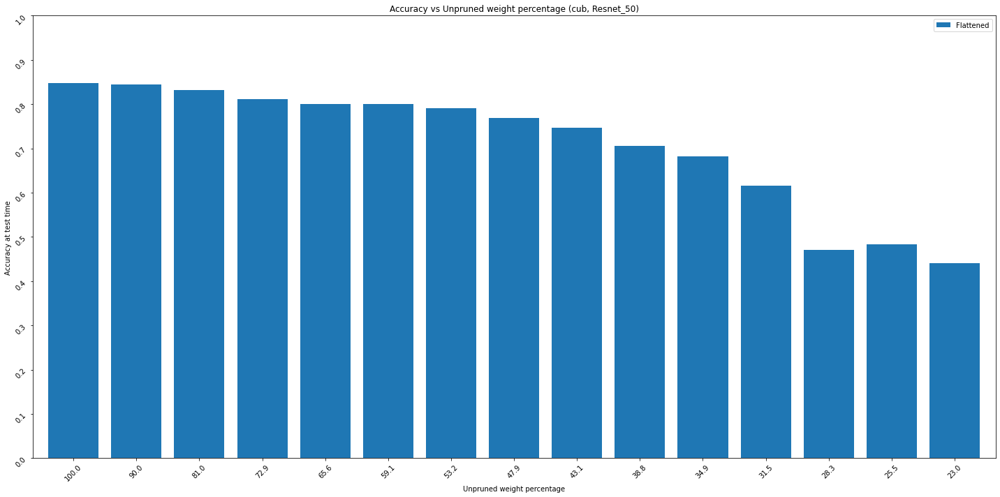

In [11]:
plot_bar_chart(acc, title="Accuracy vs Unpruned weight percentage", percent_weight_remaining=percent_weight_remains)

## TCAV visualization

In [13]:
img_dataset, attributes = get_dataset_with_image_and_attributes(
        data_root,
        json_root,
        dataset_name,
        "test",
        attribute_file_name
)

Length of the [test] dataset: 1183


In [178]:
def get_TCAV_per_concept(concepts_for_tcav, labels_for_tcav):
    stats = {}
    # concepts_for_tcav
    for concept in concepts_for_tcav:
        stats[concept] = []

#     print(stats)
    for i in range(15):
        prune_TCAV_path = os.path.join(
                logs,
                "predictions",
                "prune-statistics",
                model_arch,
                dataset_name,
                f"Prune_type_{prune_type}",
                f"cav_flattening_type_{cav_flattening_type}",
                labels_for_tcav[0]
        )

        cav_file = open(os.path.join(prune_TCAV_path, f"TCAV_scores_file_pruning_iter_{i}.pkl"),"rb")
        tcav = pickle.load(cav_file)
        for concept in tcav["concept_arr"]:
            stats[concept["concept_name"]].append(concept["TCAV_score"])
    
    return stats

# visualize
def visualize_image(imgs, label, num_rows, num_cols):
    fig, axis = plt.subplots(num_rows, num_cols, figsize = (8,8))
    c = 0
    for i in range(num_rows):
        for j in range(num_cols):
            axis[i][j].imshow(imgs[c])
            axis[i][j].set_title(label)
            c+=1
            
def plot_TCAV(
    TCAVs, 
    imgs, 
    class_labels, 
    concept_labels, 
    num_rows, 
    num_cols, 
    x_label, 
    y_label, 
    title, 
    percent_weight_remaining,
    figure_size=40
):
    fig, axis = plt.subplots(num_rows, num_cols, figsize = (figure_size,8))
    fig.subplots_adjust(bottom=0.1, right=12, top=0.9)
#     fig.subplots_adjust(hspace=15)

#     plt.grid(False)
#     plt.axis('off')
#     fig.suptitle('test title', fontsize=20)
#     plt.xlabel('xlabel', fontsize=18)
#     plt.ylabel('ylabel', fontsize=16)
    N = len(percent_weight_remaining)
    ind = np.arange(N)    # the x locations for the groups
    width = 0.35         # the width of the bars
    for i in range(num_cols):
#         axis[i][0].set_axis_off()
        axis[i].bar(ind, TCAVs[i], width, label="TCAV scores")
        axis[i].set_title(f"{concept_labels[i]}", fontsize=40)
        axis[i].set_xticks(ind)
        axis[i].set_yticks(np.arange(0, 1.1, 0.1))
        axis[i].set_xticklabels(percent_weight_remaining, rotation=45)
        axis[i].set_xlabel('xlabel', fontsize=30)
        axis[i].set_ylabel('ylabel', fontsize=30)
        axis[i].tick_params(axis='x', labelsize=20)
        axis[i].tick_params(axis='y', labelsize=20)

        axis[i].set_ylabel(y_label)
        axis[i].set_xlabel(x_label)
#         axis[i][0].legend()
        axis[i].autoscale_view()
    fig.subplots_adjust(bottom=0.1, right=12, top=0.9)
#     for i in range(num_rows):
#         axis[i][1].set_axis_off()
#         axis[i][1].imshow(imgs[i])
#         axis[i][1].set_title(class_labels)
    
    fig.savefig(f'/ocean/projects/asc170022p/shg121/PhD/Project_Pruning/plots/{class_labels}.png', dpi=500)
        

## Brewer_Blackbird

8 Brewer_Blackbird


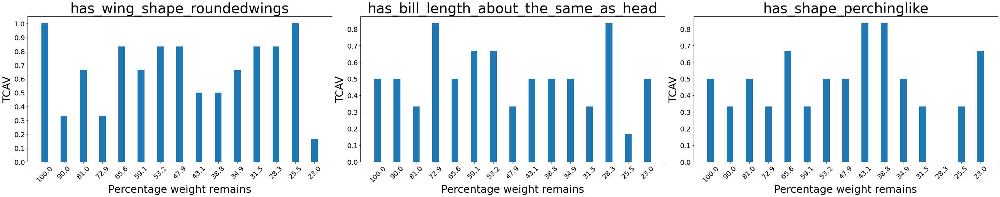

In [180]:
labels_for_tcav= [ "Brewer_Blackbird" ]
concepts_for_tcav= [ "has_breast_color_black",
                     "has_wing_shape_roundedwings",
                     "has_bill_length_about_the_same_as_head",
                     "has_shape_perchinglike" ]

label_index = labels.index(labels_for_tcav[0])
print(label_index, labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])

# print(len(imgs))
# print(imgs)
# visualize_image(imgs, labels_for_tcav[0], num_rows=2, num_cols=3)
stats = get_TCAV_per_concept(concepts_for_tcav, labels_for_tcav)   
# print(stats)

# has_wing_shape_roundedwings +ve in FOL
# has_bill_length_about_the_same_as_head and has_shape_perchinglike are -ve
TCAVs = [stats["has_wing_shape_roundedwings"], 
         stats["has_bill_length_about_the_same_as_head"],
         stats["has_shape_perchinglike"]]
concept_labels = ["has_wing_shape_roundedwings",
                     "has_bill_length_about_the_same_as_head",
                     "has_shape_perchinglike"]
plot_TCAV(
    TCAVs, 
    imgs,
    labels_for_tcav[0],
    concept_labels, 
    num_rows=1, 
    num_cols=len(TCAVs), 
    title="TCAV", 
    x_label="Percentage weight remains",
    y_label="TCAV",
    percent_weight_remaining=percent_weight_remains,
    figure_size=40
)


## Black_footed_Albatross

0 Black_footed_Albatross


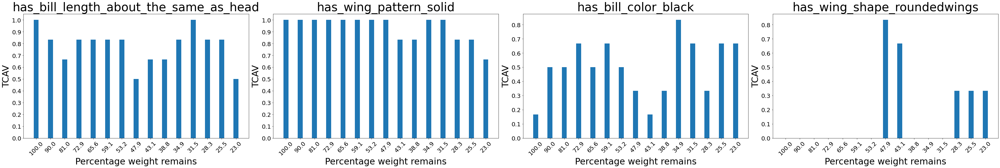

In [181]:
labels_for_tcav= [ "Black_footed_Albatross" ]
concepts_for_tcav= ["has_bill_length_about_the_same_as_head",
                    "has_wing_pattern_solid", "has_upper_tail_color_grey",
                    "has_belly_color_white", "has_wing_shape_roundedwings", 
                    "has_bill_color_black"]

label_index = labels.index(labels_for_tcav[0])
print(label_index, labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])

# print(len(imgs))
# print(imgs)
# visualize_image(imgs, labels_for_tcav[0], num_rows=2, num_cols=3)
stats = get_TCAV_per_concept(concepts_for_tcav, labels_for_tcav)   
# print(stats)

# All the concepts are positives in FOL
TCAVs = [stats["has_bill_length_about_the_same_as_head"], 
         stats["has_wing_pattern_solid"],
         stats["has_bill_color_black"], 
         stats["has_wing_shape_roundedwings"],
        ]
# 1st two are positive and rest 2 is negative
concept_labels = [
    "has_bill_length_about_the_same_as_head",
    "has_wing_pattern_solid", 
    "has_bill_color_black",
    "has_wing_shape_roundedwings"
]
plot_TCAV(
    TCAVs, 
    imgs,
    labels_for_tcav[0],
    concept_labels, 
    num_rows=1, 
    num_cols=len(TCAVs), 
    title="TCAV", 
    x_label="Percentage weight remains",
    y_label="TCAV",
    percent_weight_remaining=percent_weight_remains,
    figure_size=47
)


## Parakeet_Auklet

6 Parakeet_Auklet


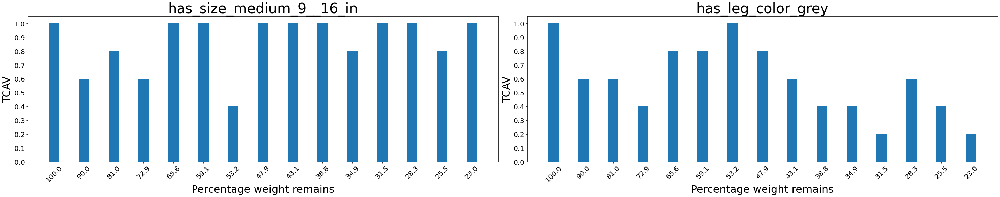

In [182]:
labels_for_tcav = [ "Parakeet_Auklet" ]
concepts_for_tcav = [ "has_size_medium_9__16_in",
                    "has_primary_color_white",
                    "has_leg_color_grey" ]

label_index = labels.index(labels_for_tcav[0])
print(label_index, labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])

# print(len(imgs))
# print(imgs)
# visualize_image(imgs, labels_for_tcav[0], num_rows=2, num_cols=3)
stats = get_TCAV_per_concept(concepts_for_tcav, labels_for_tcav)   
# print(stats)

# All the concepts are positives in FOL
TCAVs = [stats["has_size_medium_9__16_in"],
         stats["has_leg_color_grey"]
        ]
# All r +ve
concept_labels = [
    "has_size_medium_9__16_in",
    "has_leg_color_grey"
]
plot_TCAV(
    TCAVs, 
    imgs,
    labels_for_tcav[0],
    concept_labels, 
    num_rows=1, 
    num_cols=len(TCAVs), 
    title="TCAV", 
    x_label="Percentage weight remains",
    y_label="TCAV",
    percent_weight_remaining=percent_weight_remains,
    figure_size=40
)

## Red_winged_Blackbird

9 Red_winged_Blackbird


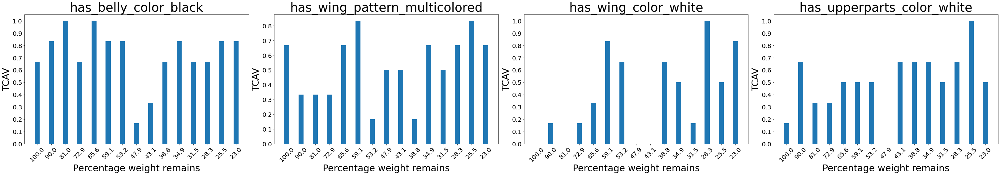

In [183]:
labels_for_tcav = [ "Red_winged_Blackbird" ]
concepts_for_tcav = [ "has_belly_color_black",
                    "has_wing_pattern_multicolored",
                    "has_wing_color_white",
                    "has_upperparts_color_white" ]

label_index = labels.index(labels_for_tcav[0])
print(label_index, labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])

# print(len(imgs))
# print(imgs)
# visualize_image(imgs, labels_for_tcav[0], num_rows=2, num_cols=3)
stats = get_TCAV_per_concept(concepts_for_tcav, labels_for_tcav)   
# print(stats)

# All the concepts are positives in FOL
TCAVs = [stats["has_belly_color_black"],
         stats["has_wing_pattern_multicolored"],
         stats["has_wing_color_white"],
         stats["has_upperparts_color_white"]
        ]
# has_belly_color_black and  has_wing_pattern_multicolored r +ve
# has_wing_color_white is -ve
# has_upperparts_color_white random
concept_labels = [
    "has_belly_color_black",
    "has_wing_pattern_multicolored",
    "has_wing_color_white",
    "has_upperparts_color_white"
]
plot_TCAV(
    TCAVs, 
    imgs,
    labels_for_tcav[0],
    concept_labels, 
    num_rows=1, 
    num_cols=len(TCAVs), 
    title="TCAV", 
    x_label="Percentage weight remains",
    y_label="TCAV",
    percent_weight_remaining=percent_weight_remains,
    figure_size=45
)

## Least_Auklet

5 Least_Auklet


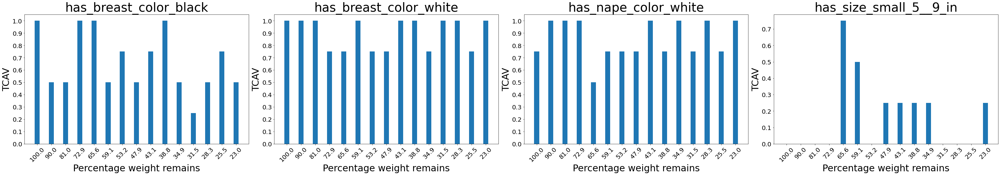

In [184]:
labels_for_tcav = [ "Least_Auklet" ]
concepts_for_tcav = [ "has_breast_color_black",
                    "has_breast_color_white",
                     "has_nape_color_white",
                    "has_size_small_5__9_in"]

label_index = labels.index(labels_for_tcav[0])
print(label_index, labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])

# print(len(imgs))
# print(imgs)
# visualize_image(imgs, labels_for_tcav[0], num_rows=2, num_cols=3)
stats = get_TCAV_per_concept(concepts_for_tcav, labels_for_tcav)   
# print(stats)

# All the concepts are positives in FOL
TCAVs = [stats["has_breast_color_black"],
         stats["has_breast_color_white"],
         stats["has_nape_color_white"],
         stats["has_size_small_5__9_in"]
        ]
# has_breast_color_black and  has_breast_color_white r +ve
# has_nape_color_white and has_size_small_5__9_in is -ve

concept_labels = [
    "has_breast_color_black",
    "has_breast_color_white",
    "has_nape_color_white",
    "has_size_small_5__9_in"
]
plot_TCAV(
    TCAVs, 
    imgs,
    labels_for_tcav[0],
    concept_labels, 
    num_rows=1, 
    num_cols=len(TCAVs), 
    title="TCAV", 
    x_label="Percentage weight remains",
    y_label="TCAV",
    percent_weight_remaining=percent_weight_remains,
    figure_size=45
)

## Rusty_Blackbird

10 Rusty_Blackbird


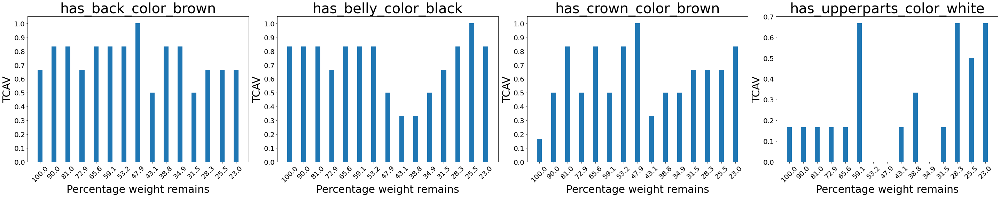

In [185]:
labels_for_tcav = [ "Rusty_Blackbird" ]
concepts_for_tcav = [ "has_back_color_brown",
                     "has_belly_color_black",
                     "has_crown_color_brown",
                     "has_upperparts_color_white" ]

label_index = labels.index(labels_for_tcav[0])
print(label_index, labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])

# print(len(imgs))
# print(imgs)
# visualize_image(imgs, labels_for_tcav[0], num_rows=2, num_cols=3)
stats = get_TCAV_per_concept(concepts_for_tcav, labels_for_tcav)   
# print(stats)

# All the concepts are positives in FOL
TCAVs = [stats["has_back_color_brown"],
         stats["has_belly_color_black"],
         stats["has_crown_color_brown"],
         stats["has_upperparts_color_white"]
        ]
# has_back_color_brown and has_belly_color_black r +ve
# has_crown_color_brown is -ve
# has_upperparts_color_white is random

concept_labels = [
    "has_back_color_brown",
    "has_belly_color_black",
    "has_crown_color_brown",
    "has_upperparts_color_white"
]
plot_TCAV(
    TCAVs, 
    imgs,
    labels_for_tcav[0],
    concept_labels, 
    num_rows=1, 
    num_cols=len(TCAVs), 
    title="TCAV", 
    x_label="Percentage weight remains",
    y_label="TCAV",
    percent_weight_remaining=percent_weight_remains,
    figure_size=40
)

In [225]:
acc[0]

0.8478444632290786

## Grad CAM visualization

In [225]:
def visualize_Grad_CAM_j2(image, heatmaps_j2, bird_class, percent_weight_remaining):
    plt.axis('off')
    plt.imshow(image)
    fig, axis = plt.subplots(5, 3, figsize = (50, 50))
    c = 0
    for i in range(5):
        for j in range(3):
            axis[i][j].set_axis_off()
            axis[i][j].imshow(image)
            axis[i][j].imshow(heatmaps_j2[c])
            axis[i][j].set_title(
                f"% Weight remaining (Accuracy): {percent_weight_remaining[c]}({round(acc[c], 2)})", 
                fontsize=30
            )
            c+=1
    

def visualize_Grad_CAM_j3(image, heatmaps_j3, bird_class, percent_weight_remaining):
    np_img = np.array(image)
    fig, axis = plt.subplots(5, 3, figsize = (50, 50))
    c = 0
    for i in range(5):
        for j in range(3):
            axis[i][j].set_axis_off()
            axis[i][j].imshow(np_img * heatmaps_j3[c])
            axis[i][j].set_title(
                f"% of weight remaining: {percent_weight_remaining[c]}", 
                fontsize=40
            )
            c+=1
    fig.savefig(f'/ocean/projects/asc170022p/shg121/PhD/Project_Pruning/plots/{bird_class}_gradcam.png', dpi=220)
    

## Just change the img_id and make sure it should be in sync with the one in main_heatmap_save.py

## Black_footed_Albatross

In [218]:
labels_for_tcav = ["Black_footed_Albatross"]
heatmap_save_path = os.path.join(
        logs,
        "predictions",
        "prune-statistics",
        model_arch,
        dataset_name,
        f"Prune_type_{prune_type}",
        f"cav_flattening_type_{cav_flattening_type}",
        labels_for_tcav[0],
        "heatmaps"
    )
heatmap_j2_arr = []
heatmap_j3_arr = []

label_index = labels.index(labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])
        
img_id = 0
img_to_plot = imgs[img_id]
img_to_plot_resize = img_to_plot.resize((224, 224))

for ite in range(15):
    heatmap_j2_file = f"heatmap_j2_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j3_file = f"heatmap_j3_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j2_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j2_file)))
    heatmap_j3_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j3_file)))

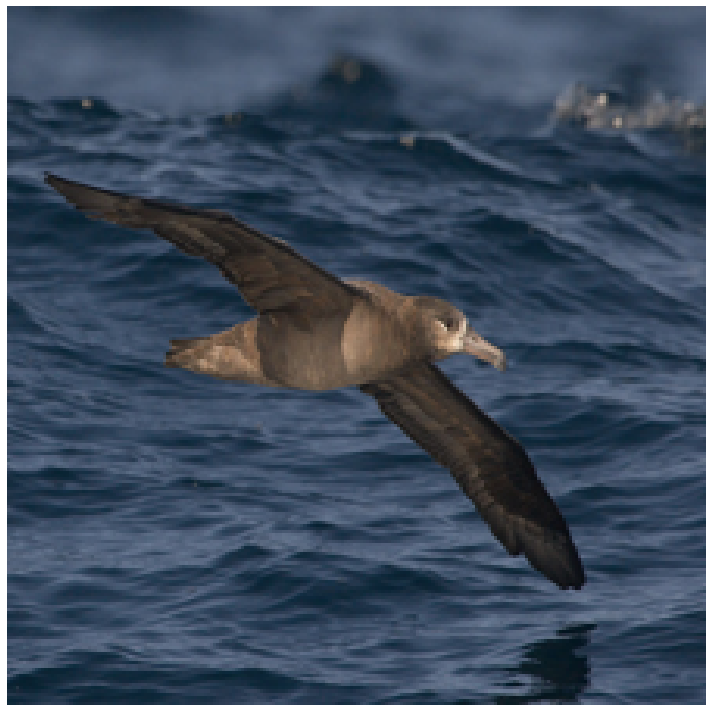

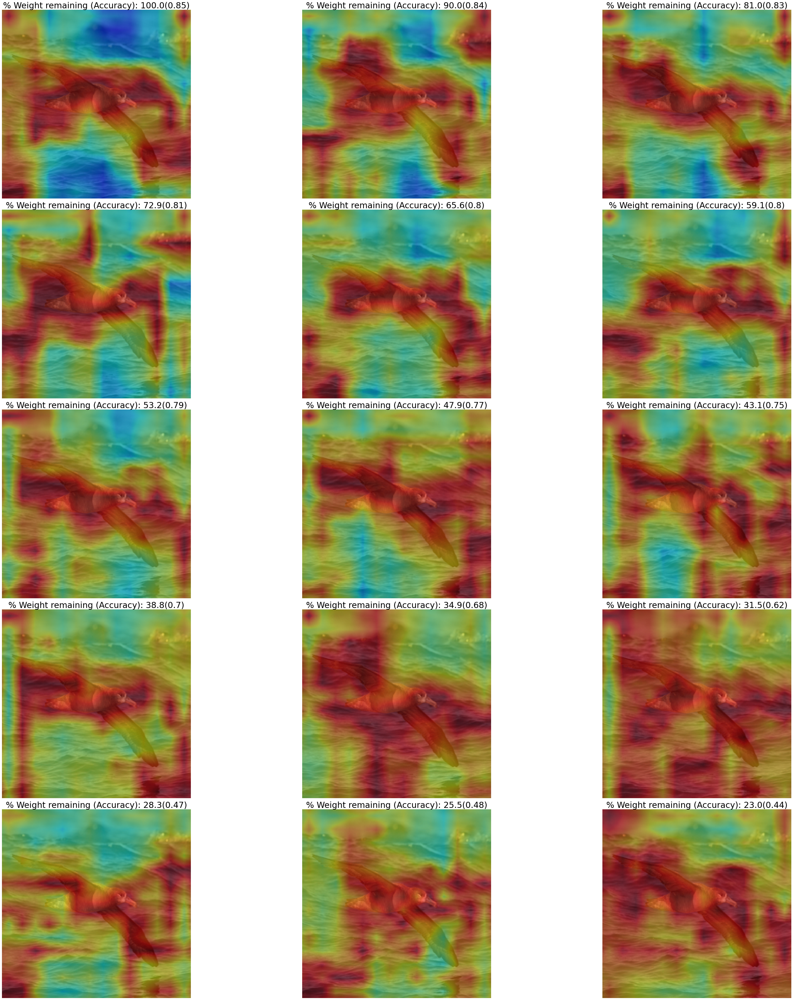

In [219]:
visualize_Grad_CAM_j2(
    img_to_plot_resize, 
    heatmap_j2_arr, 
    bird_class=labels_for_tcav[0], 
    percent_weight_remaining=percent_weight_remains
)

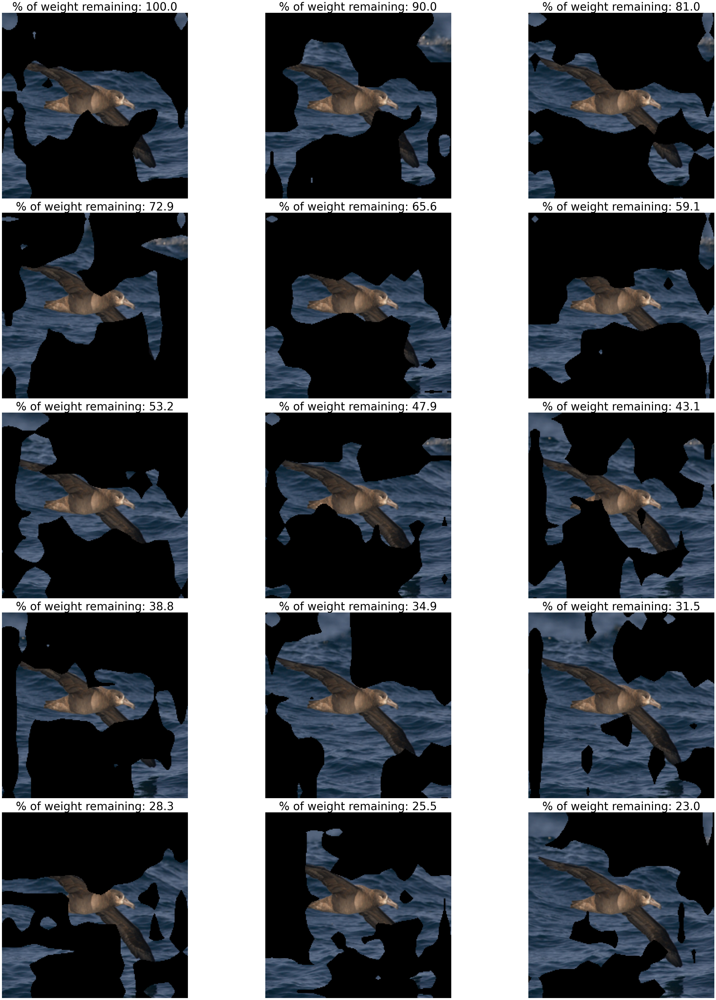

In [226]:
visualize_Grad_CAM_j3(
    img_to_plot_resize, 
    heatmap_j3_arr, 
    bird_class=labels_for_tcav[0],
    percent_weight_remaining=percent_weight_remains
)

## Rusty_Blackbird

In [227]:
labels_for_tcav = ["Rusty_Blackbird"]
heatmap_save_path = os.path.join(
        logs,
        "predictions",
        "prune-statistics",
        model_arch,
        dataset_name,
        f"Prune_type_{prune_type}",
        f"cav_flattening_type_{cav_flattening_type}",
        labels_for_tcav[0],
        "heatmaps"
    )
heatmap_j2_arr = []
heatmap_j3_arr = []

label_index = labels.index(labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])
        
img_id = 3
img_to_plot = imgs[img_id]
img_to_plot_resize = img_to_plot.resize((224, 224))

for ite in range(15):
    heatmap_j2_file = f"heatmap_j2_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j3_file = f"heatmap_j3_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j2_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j2_file)))
    heatmap_j3_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j3_file)))



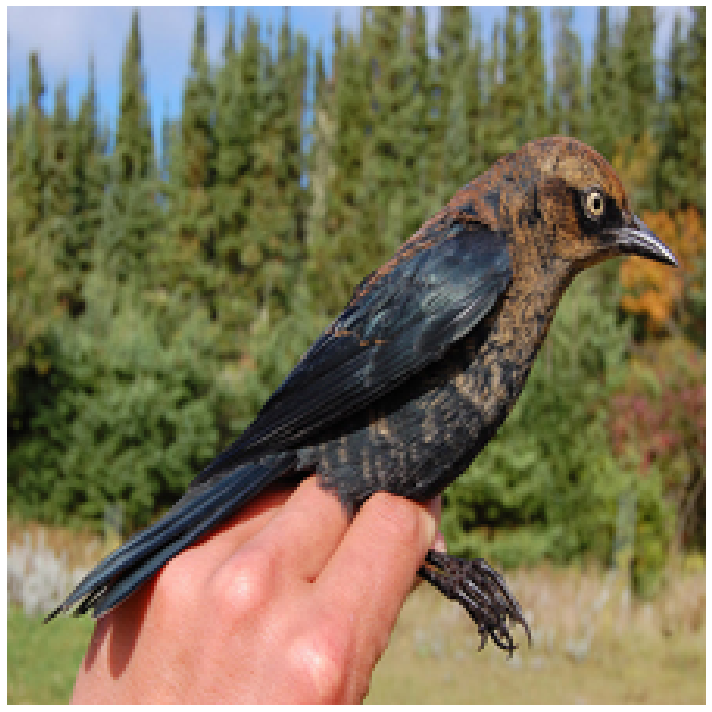

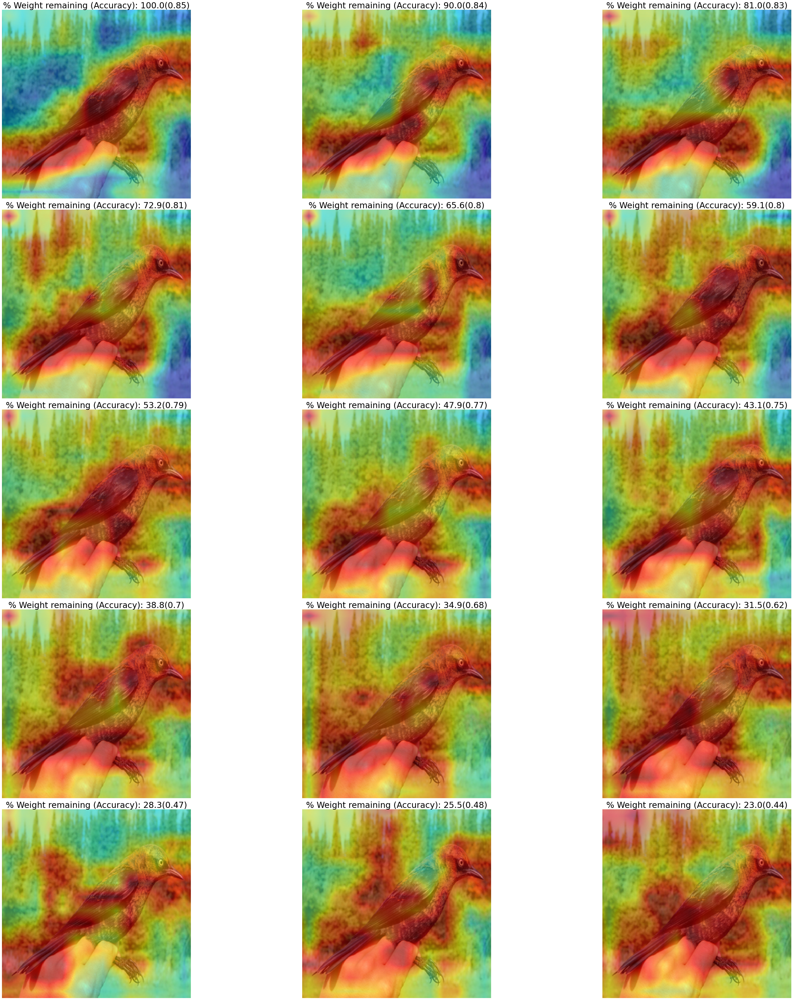

In [228]:
visualize_Grad_CAM_j2(
    img_to_plot_resize, 
    heatmap_j2_arr, 
    bird_class=labels_for_tcav[0],
    percent_weight_remaining=percent_weight_remains
)

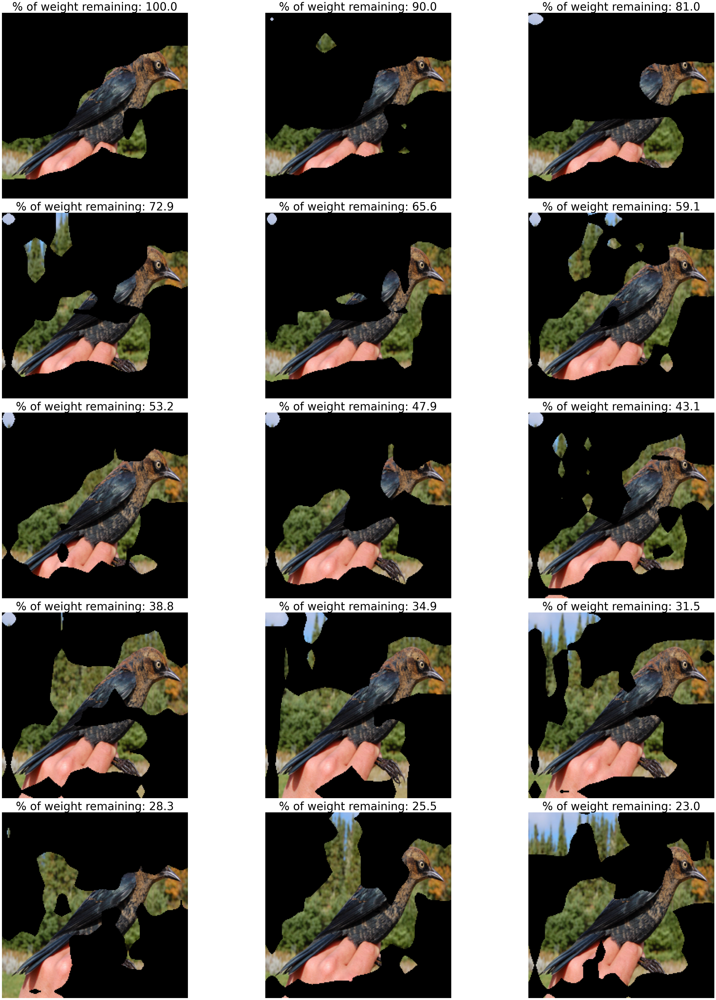

In [229]:
visualize_Grad_CAM_j3(
    img_to_plot_resize, 
    heatmap_j3_arr, 
    bird_class=labels_for_tcav[0],
    percent_weight_remaining=percent_weight_remains
)

## Least_Auklet

In [230]:
labels_for_tcav = ["Least_Auklet"]
heatmap_save_path = os.path.join(
        logs,
        "predictions",
        "prune-statistics",
        model_arch,
        dataset_name,
        f"Prune_type_{prune_type}",
        f"cav_flattening_type_{cav_flattening_type}",
        labels_for_tcav[0],
        "heatmaps"
    )
heatmap_j2_arr = []
heatmap_j3_arr = []

label_index = labels.index(labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])
        
img_id = 1
img_to_plot = imgs[img_id]
img_to_plot_resize = img_to_plot.resize((224, 224))

for ite in range(15):
    heatmap_j2_file = f"heatmap_j2_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j3_file = f"heatmap_j3_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j2_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j2_file)))
    heatmap_j3_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j3_file)))

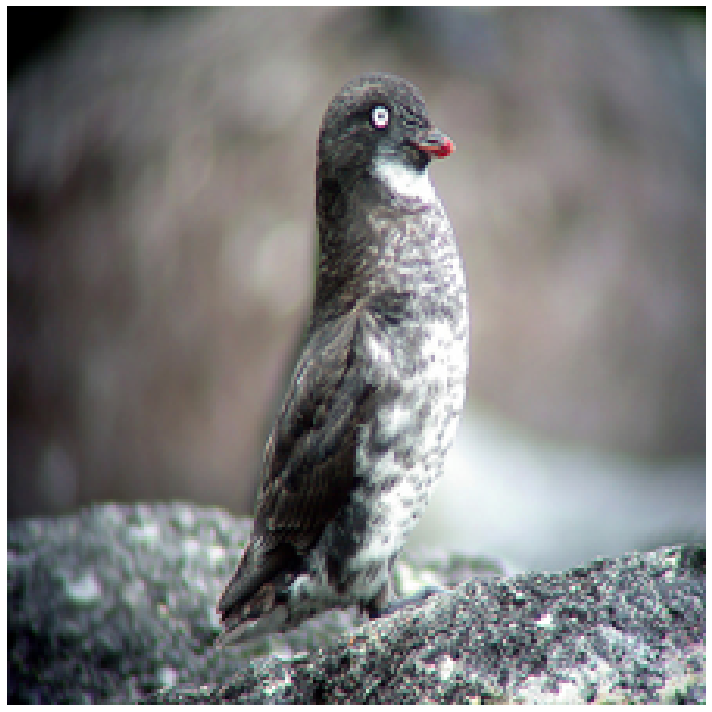

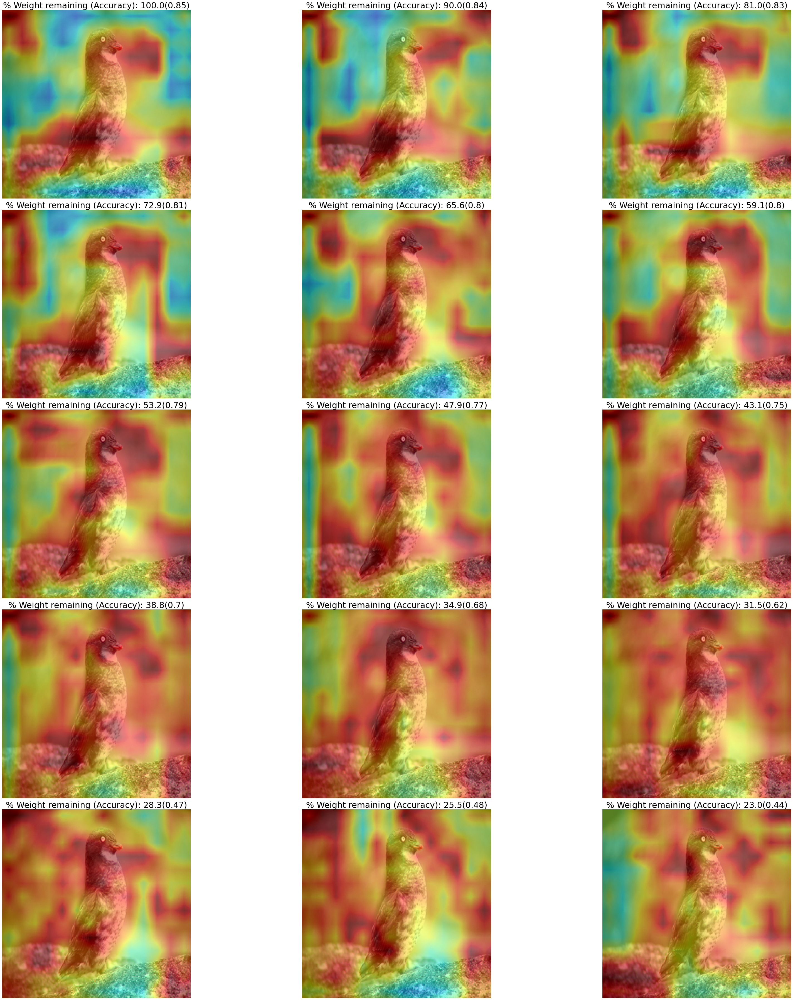

In [231]:
visualize_Grad_CAM_j2(
    img_to_plot_resize, 
    heatmap_j2_arr, 
    bird_class=labels_for_tcav[0],
    percent_weight_remaining=percent_weight_remains
)

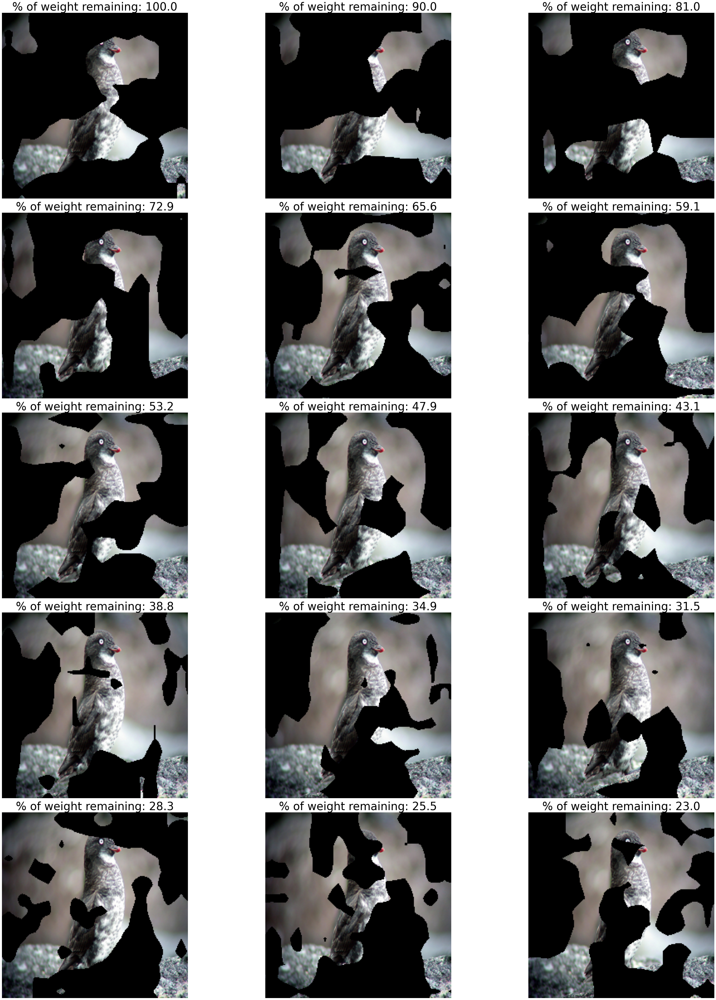

In [232]:
visualize_Grad_CAM_j3(
    img_to_plot_resize, 
    heatmap_j3_arr, 
    bird_class=labels_for_tcav[0],
    percent_weight_remaining=percent_weight_remains
)

## Parakeet_Auklet

In [233]:
labels_for_tcav = ["Parakeet_Auklet"]
heatmap_save_path = os.path.join(
        logs,
        "predictions",
        "prune-statistics",
        model_arch,
        dataset_name,
        f"Prune_type_{prune_type}",
        f"cav_flattening_type_{cav_flattening_type}",
        labels_for_tcav[0],
        "heatmaps"
    )
heatmap_j2_arr = []
heatmap_j3_arr = []

label_index = labels.index(labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])
        
img_id = 0
img_to_plot = imgs[img_id]
img_to_plot_resize = img_to_plot.resize((224, 224))

for ite in range(15):
    heatmap_j2_file = f"heatmap_j2_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j3_file = f"heatmap_j3_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j2_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j2_file)))
    heatmap_j3_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j3_file)))

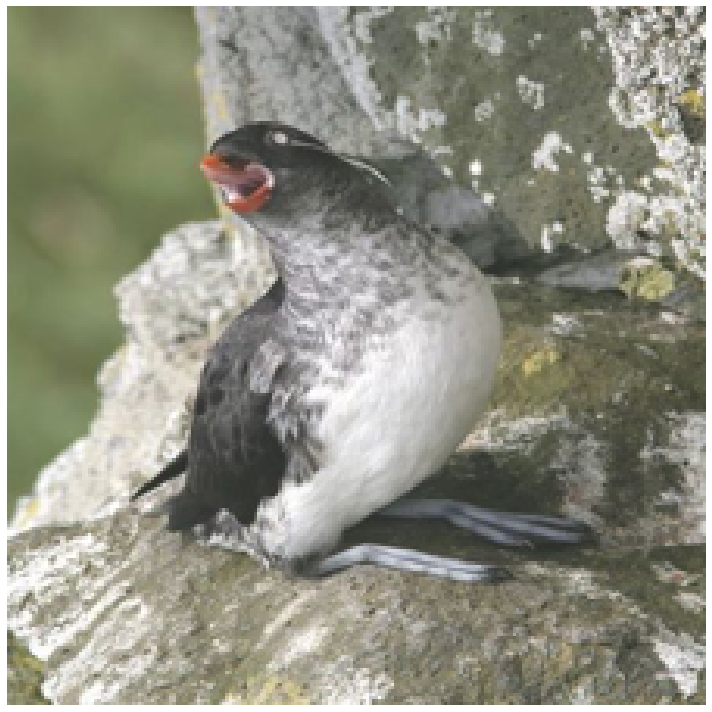

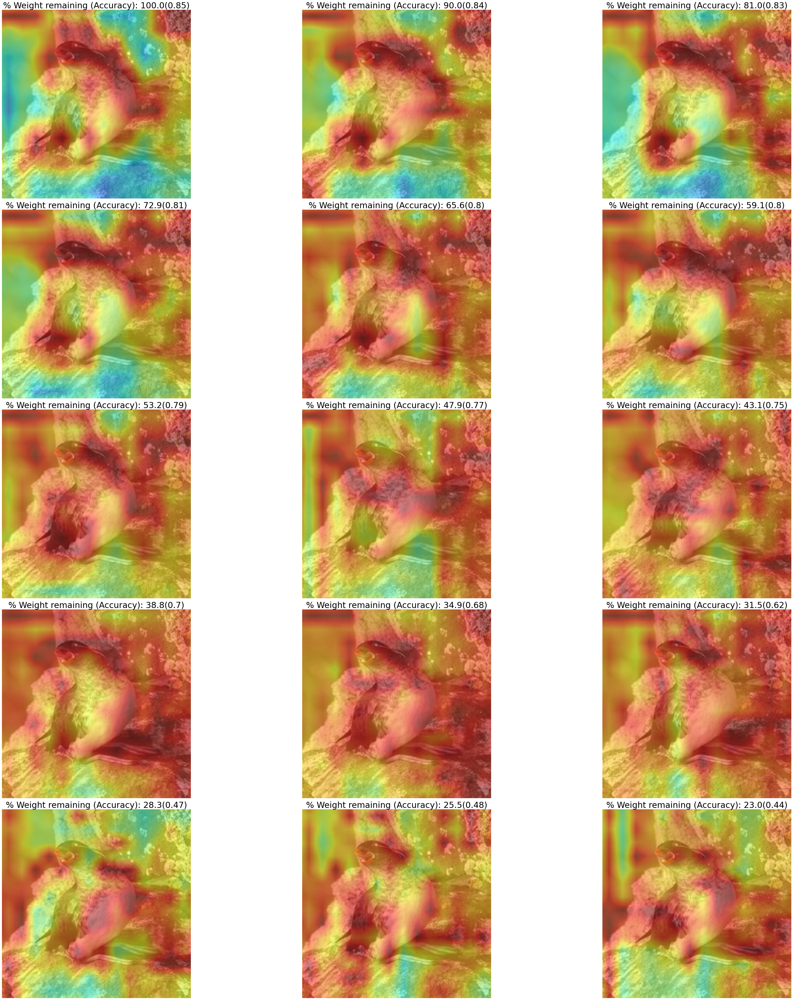

In [234]:
visualize_Grad_CAM_j2(
    img_to_plot_resize, 
    heatmap_j2_arr, 
    bird_class=labels_for_tcav[0],
    percent_weight_remaining=percent_weight_remains
)

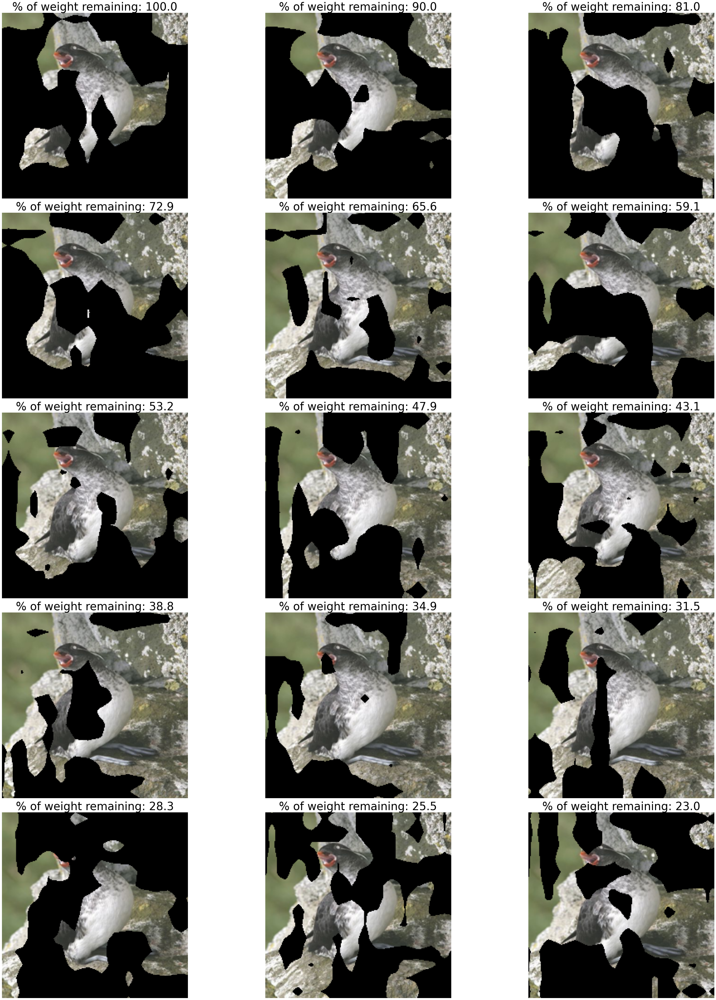

In [235]:
visualize_Grad_CAM_j3(
    img_to_plot_resize, 
    heatmap_j3_arr, 
    bird_class=labels_for_tcav[0],
    percent_weight_remaining=percent_weight_remains
)

## Red_winged_Blackbird

In [236]:
labels_for_tcav = ["Red_winged_Blackbird"]
heatmap_save_path = os.path.join(
        logs,
        "predictions",
        "prune-statistics",
        model_arch,
        dataset_name,
        f"Prune_type_{prune_type}",
        f"cav_flattening_type_{cav_flattening_type}",
        labels_for_tcav[0],
        "heatmaps"
    )
heatmap_j2_arr = []
heatmap_j3_arr = []

label_index = labels.index(labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])
        
img_id = 2
img_to_plot = imgs[img_id]
img_to_plot_resize = img_to_plot.resize((224, 224))

for ite in range(15):
    heatmap_j2_file = f"heatmap_j2_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j3_file = f"heatmap_j3_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j2_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j2_file)))
    heatmap_j3_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j3_file)))

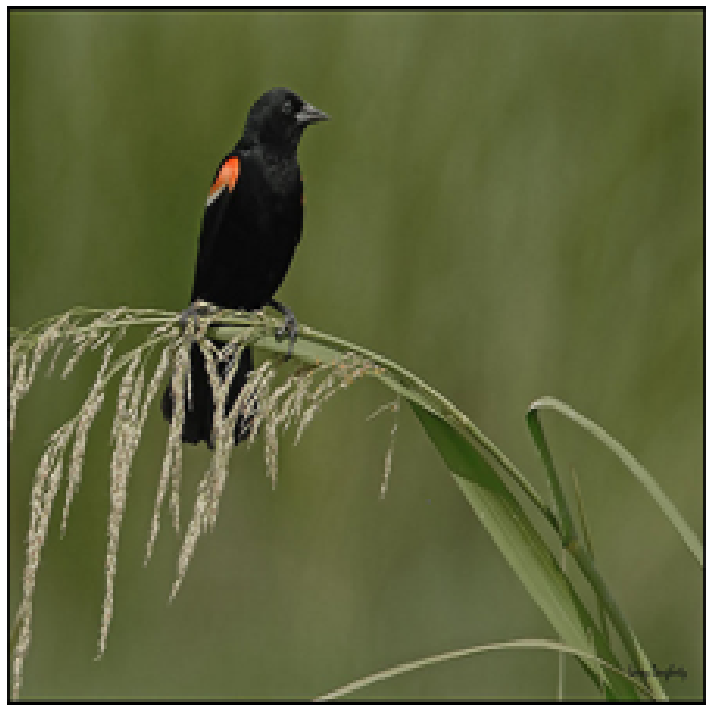

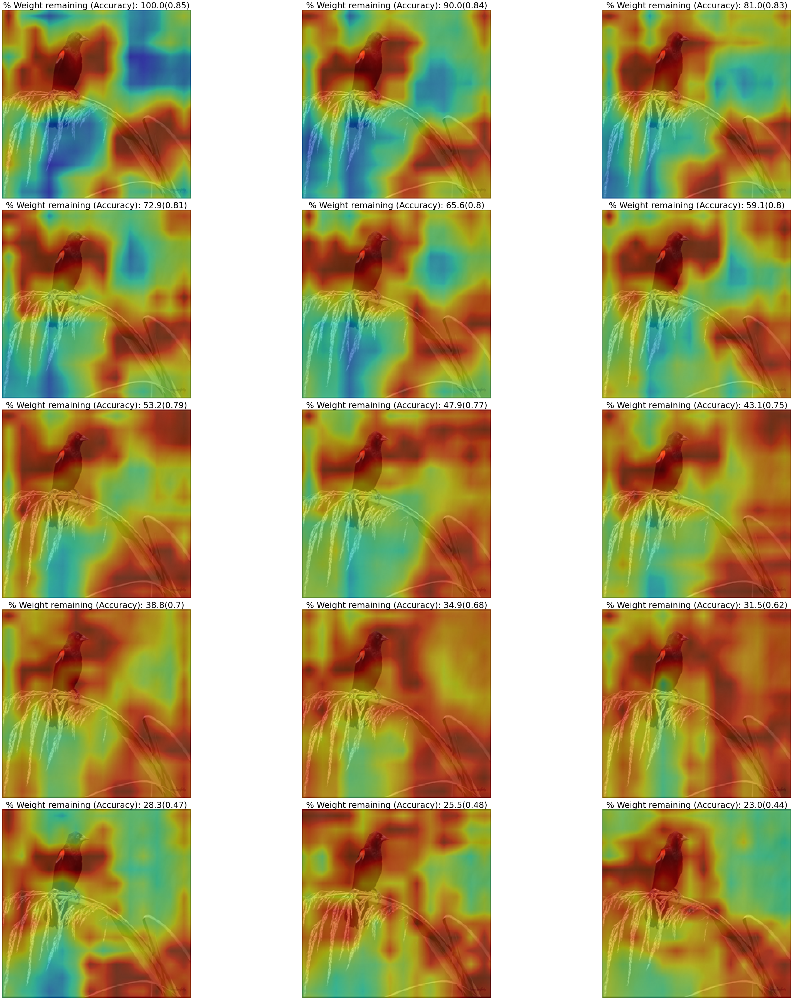

In [237]:
visualize_Grad_CAM_j2(
    img_to_plot_resize, 
    heatmap_j2_arr, 
    bird_class=labels_for_tcav[0],
    percent_weight_remaining=percent_weight_remains
)

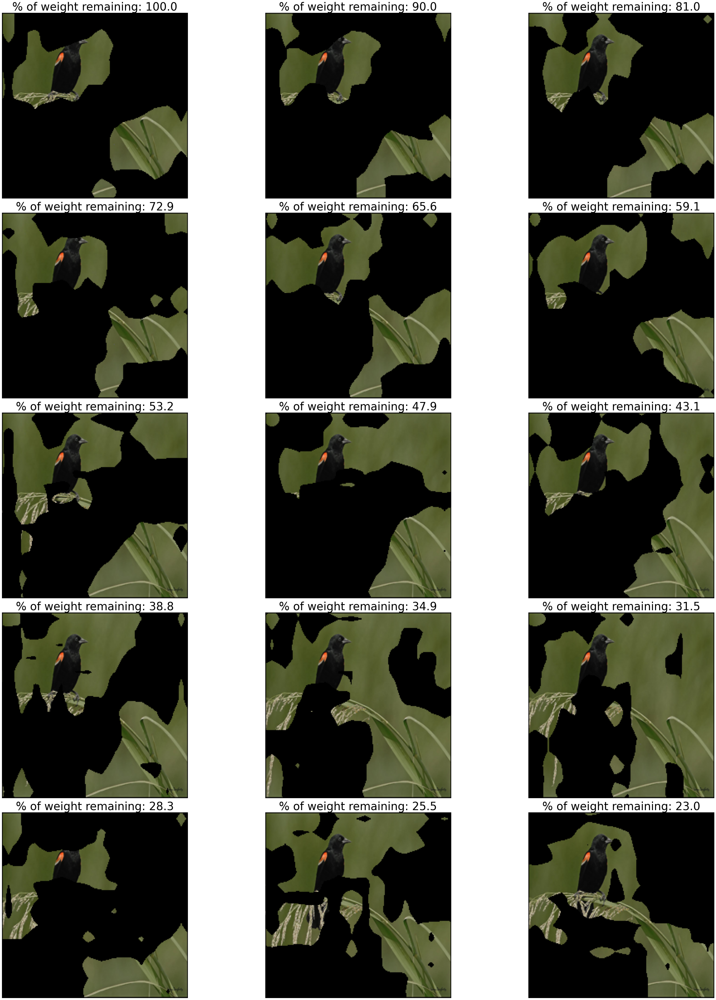

In [238]:
visualize_Grad_CAM_j3(
    img_to_plot_resize, 
    heatmap_j3_arr, 
    bird_class=labels_for_tcav[0],
    percent_weight_remaining=percent_weight_remains
)

## Brewer Blackbird

In [240]:
labels_for_tcav = ["Brewer_Blackbird"]
heatmap_save_path = os.path.join(
        logs,
        "predictions",
        "prune-statistics",
        model_arch,
        dataset_name,
        f"Prune_type_{prune_type}",
        f"cav_flattening_type_{cav_flattening_type}",
        labels_for_tcav[0],
        "heatmaps"
    )
heatmap_j2_arr = []
heatmap_j3_arr = []

label_index = labels.index(labels_for_tcav[0])
imgs = []
for ds in img_dataset:
    if ds[1] == label_index:
        imgs.append(ds[0])
        
img_id = 2
img_to_plot = imgs[img_id]
img_to_plot_resize = img_to_plot.resize((224, 224))

for ite in range(15):
    heatmap_j2_file = f"heatmap_j2_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j3_file = f"heatmap_j3_prune_iteration_{ite}_image_id_{img_id}.npy"
    heatmap_j2_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j2_file)))
    heatmap_j3_arr.append(np.load(os.path.join(heatmap_save_path, heatmap_j3_file)))

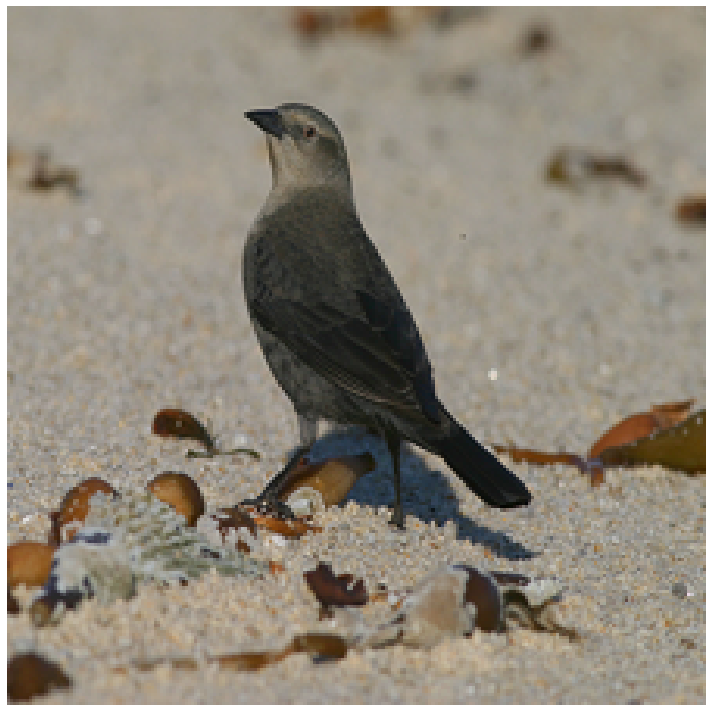

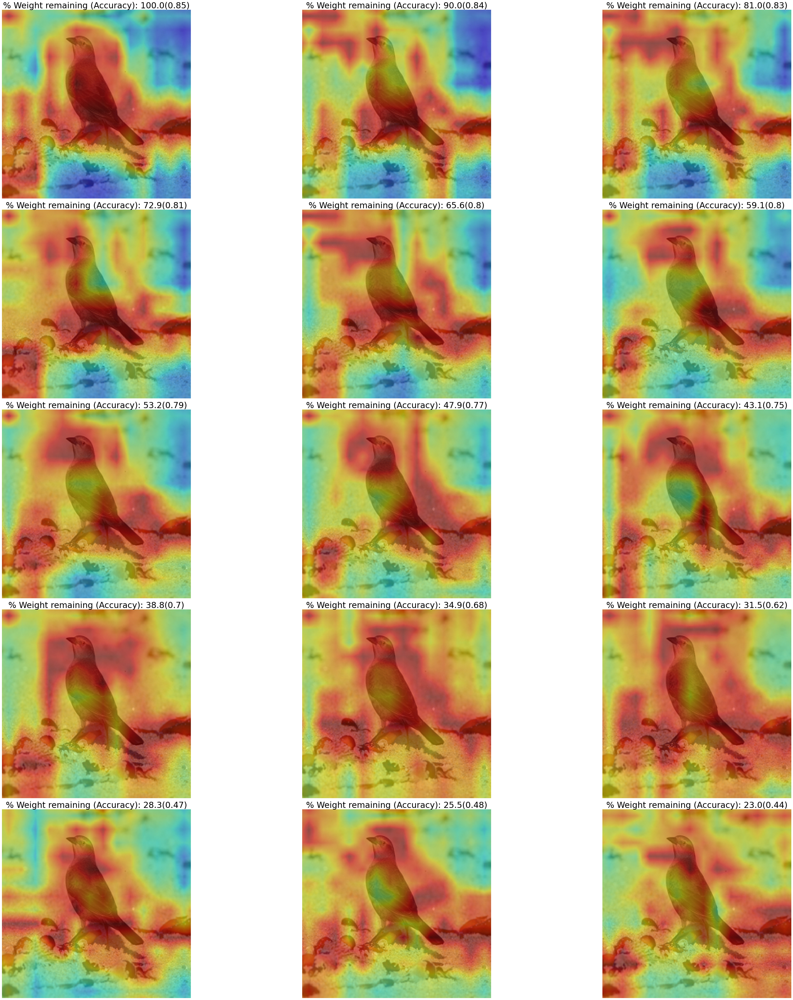

In [241]:
visualize_Grad_CAM_j2(
    img_to_plot_resize, 
    heatmap_j2_arr, 
    bird_class=labels_for_tcav[0],
    percent_weight_remaining=percent_weight_remains
)

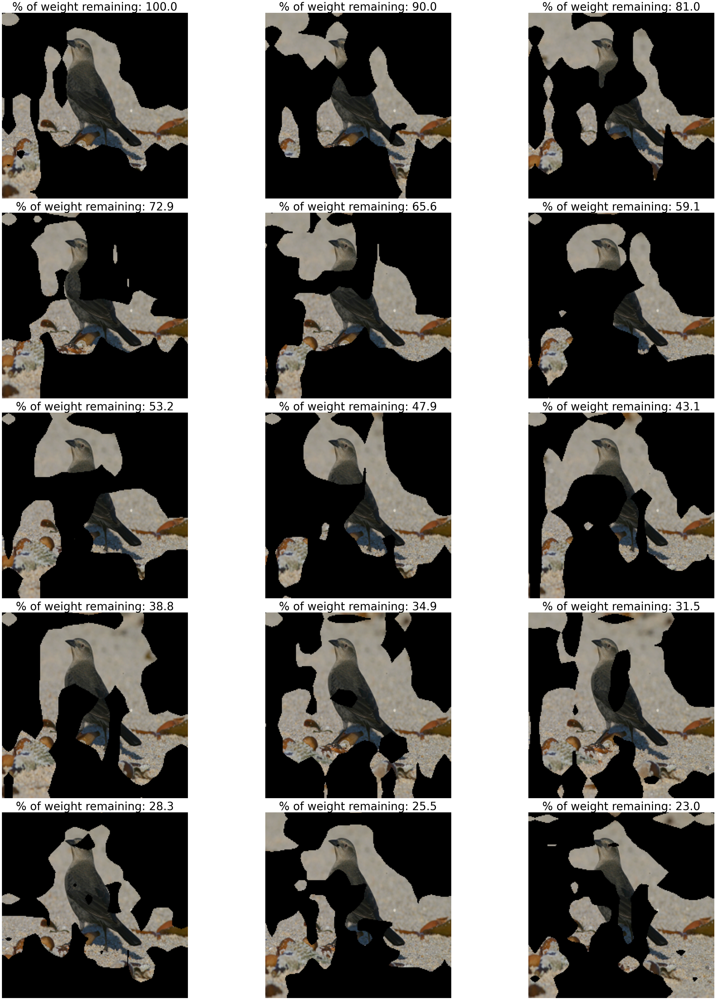

In [242]:
visualize_Grad_CAM_j3(
    img_to_plot_resize, 
    heatmap_j3_arr, 
    bird_class=labels_for_tcav[0],
    percent_weight_remaining=percent_weight_remains
)

In [254]:
def plot_graph(BB, percent_weight, title, y_label, x_label):
    a = np.arange(len(BB))  
    plt.rcParams["figure.figsize"] = (10,5)
    plt.plot(a, np.array(BB), c="blue", label="Winning tickets") 
    plt.title(f"{'CUB-200'} ({'ResNet50'})", fontdict={'fontsize': 20}) 
    plt.xlabel(x_label, fontsize=15) 
    plt.ylabel(y_label, fontsize=15) 
    plt.xticks(a, percent_weight, fontsize=12, rotation ="vertical") 
    plt.yticks(fontsize=12)
    plt.grid(color="gray") 
    plt.tight_layout()
    plt.savefig(f'/ocean/projects/asc170022p/shg121/PhD/Project_Pruning/plots/cub_quant.png', dpi=220)
    # plt.savefig(f"{plot_path}/{prune_type}_val_Accuracy_Vs_Weights.png", dpi=1200) 
    plt.show()
    plt.close()

In [248]:
len(acc), len(percent_weight_remaining)

(15, 25)

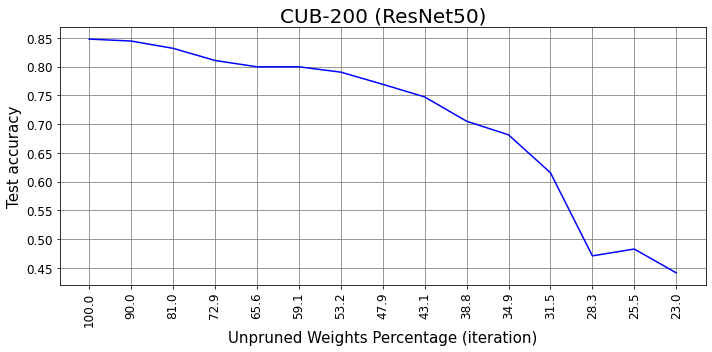

In [255]:
plot_graph(
    acc, 
    percent_weight_remains, 
    title="Test Accuracy vs Unpruned Weights Percentage", 
    y_label="Test accuracy", 
    x_label="Unpruned Weights Percentage (iteration)",
)